In [1]:
# !pip install emoji
# nltk.download('stopwords')
# nltk.download('punkt')
# !pip3 install wordcloud

In [43]:
import pandas as pd
import nltk
from collections import Counter
import emoji

from nltk.corpus import stopwords 
from nltk.tokenize import word_tokenize
import numpy as np

import matplotlib.pyplot as plt
%matplotlib inline

plt.rcParams["axes.edgecolor"] = "black"
plt.rcParams["axes.linewidth"] = 10

import matplotlib.pyplot as pPlot
from wordcloud import WordCloud, STOPWORDS,ImageColorGenerator
import numpy as npy
from PIL import Image

In [44]:
fpr = open("whatsapp_data/WhatsApp Chat with Classmates🎉🎊😎_v2.txt","r",encoding='utf-8')
lines = fpr.readlines()
fpr.close()

lines_preprocessed = []
for l in lines:
    x=l
    if len(x.split(',')[0].split('/'))==3:
        lines_preprocessed.append(x.strip())
    else:
        lines_preprocessed[-1] += ' '+str(x.strip())

In [46]:
len(lines),len(lines_preprocessed)

(13567, 9210)

In [47]:
# df = pd.read_csv("WhatsApp Chat with Classmates🎉🎊😎.txt",sep="|",header=None,names=["line"])
df = pd.DataFrame(lines_preprocessed,columns=["line"])
df.head()

In [49]:
def get_name(x):
    name = "#"
    try:
        if (len(x.split(":"))!=3) or (len(x.split(":")[1].split('-'))<=1):
            name = "" 
        elif (len(x.split(":"))==3):
            name = x.split(":")[1].split('-')[1]
    except:
        print(x)
        name = '@'
    return name

def extract_emojis(s):
    return ''.join(c for c in s if c in emoji.UNICODE_EMOJI)

def get_words(x):
    line = x.strip()
    try :
        line = line.split(":")[2]
    except:#system msgs like {'someone left','changed group icon'}
        line = ""
    return line.split()


df['date']= df['line'].apply(lambda x:x.split(":")[0].split(',')[0])
df['is_comment'] = df['line'].apply(lambda x:len(x.split(":"))>1)
df['name']= df['line'].apply(lambda x:get_name(x))
df['emojis'] = df['line'].apply(lambda x: extract_emojis(x))
df['words'] = df['line'].apply(lambda x:get_words(x))

In [50]:
df.tail(10)

,line,date,is_comment,name,emojis,words
9200,"6/5/20, 11:56 PM - Kalmeshwar Gurav: bhetl tri...",6/5/20,True,Kalmeshwar Gurav,🤣🤣,"[bhetl, tri, hot, ka, call, kelta, phact, 🤣🤣]"
9201,"6/5/20, 11:56 PM - Ashutosh Kurade JNVK: Z san...",6/5/20,True,Ashutosh Kurade JNVK,🤐,"[Z, sangal, 🤐]"
9202,"6/5/20, 11:58 PM - Omkar Zirangi JNVK: Bhetlel...",6/5/20,True,Omkar Zirangi JNVK,😂,"[Bhetlelo, bhai😂vichar, tela]"
9203,"6/5/20, 11:58 PM - Ashutosh Kurade JNVK: Jatan...",6/5/20,True,Ashutosh Kurade JNVK,,"[Jatana, travels, pakdtana]"
9204,"6/6/20, 12:00 AM - Omkar Zirangi JNVK: Bhai ba...",6/6/20,True,Omkar Zirangi JNVK,😄,"[Bhai, banglore, traffic, mumbai, preksha, har..."
9205,"6/6/20, 12:01 AM - Ashutosh Kurade JNVK: Asude...",6/6/20,True,Ashutosh Kurade JNVK,,"[Asude, ghe, ata, tuzi, hyabusa, navati, nytr,..."
9206,"6/6/20, 12:02 AM - Omkar Zirangi JNVK: Yeah🙌🏻😆",6/6/20,True,Omkar Zirangi JNVK,🙌🏻😆,[Yeah🙌🏻😆]
9207,"6/6/20, 12:52 AM - Omkar Zirangi JNVK: https:/...",6/6/20,True,,,[https]
9208,"6/6/20, 12:53 AM - Omkar Zirangi JNVK: A glimp...",6/6/20,True,Omkar Zirangi JNVK,,"[A, glimpse, of, last, year's, Shivrajyabhishe..."
9209,"6/6/20, 1:54 AM - Ashutosh Kurade JNVK: 🙌🏻🙌🏻",6/6/20,True,Ashutosh Kurade JNVK,🙌🏻🙌🏻,[🙌🏻🙌🏻]


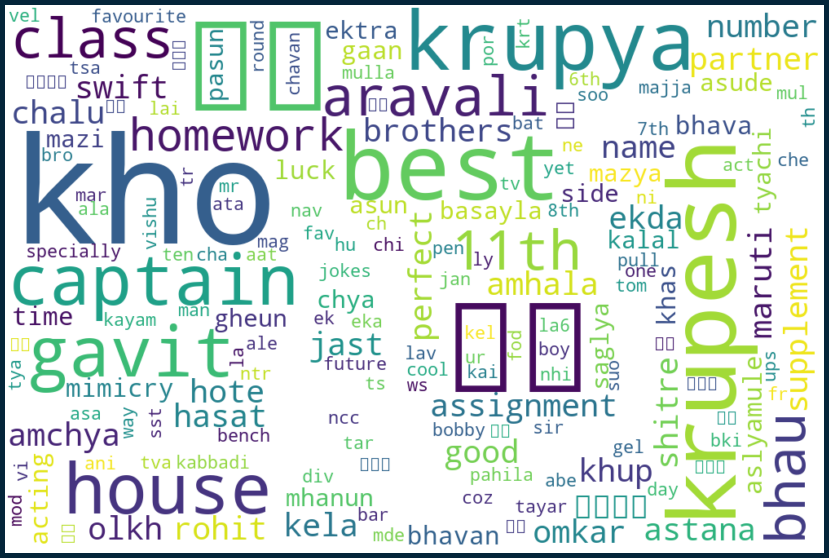

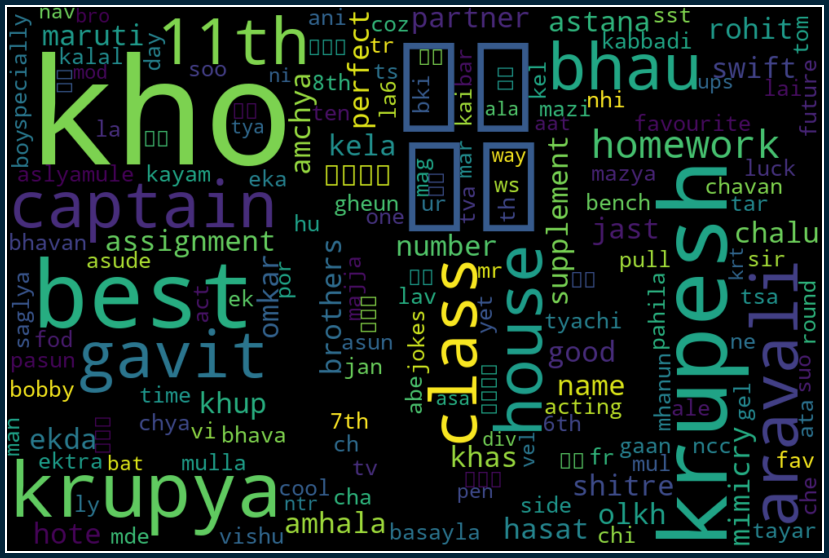

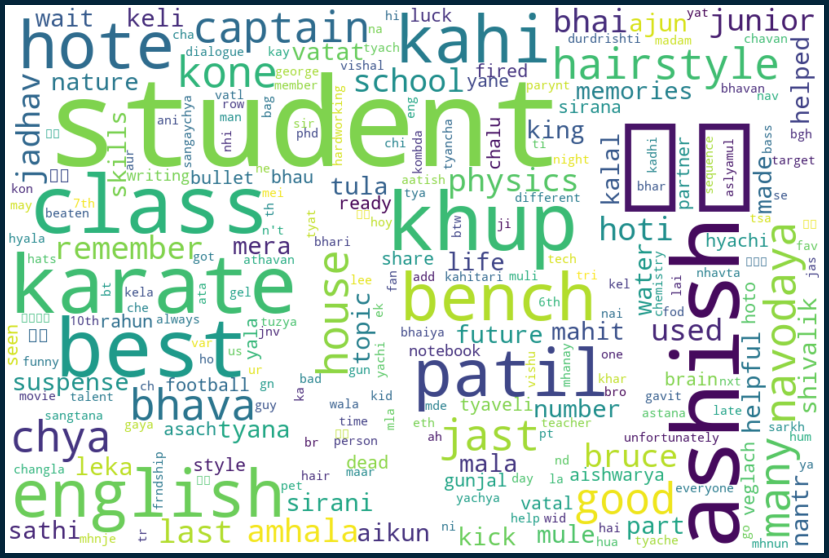

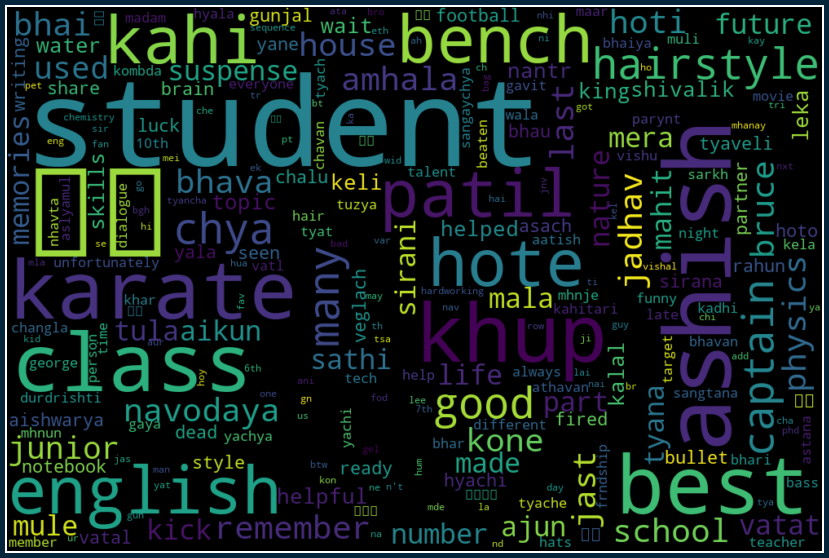

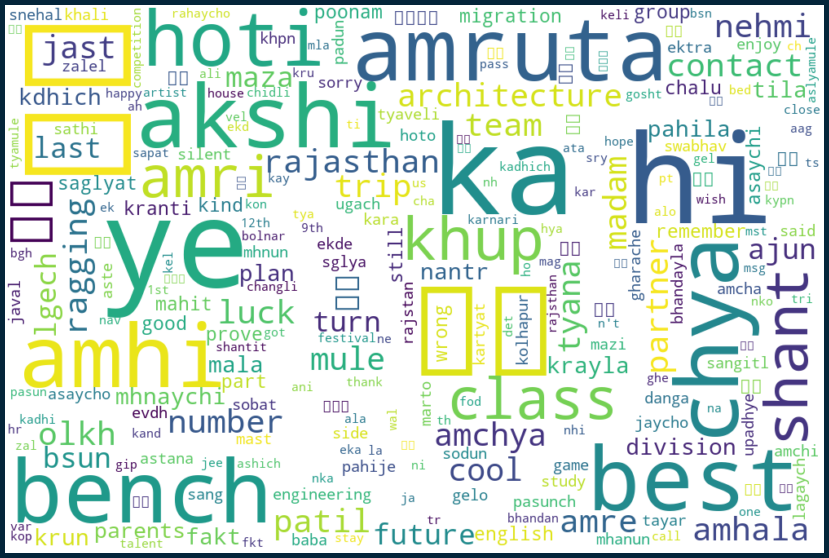

...

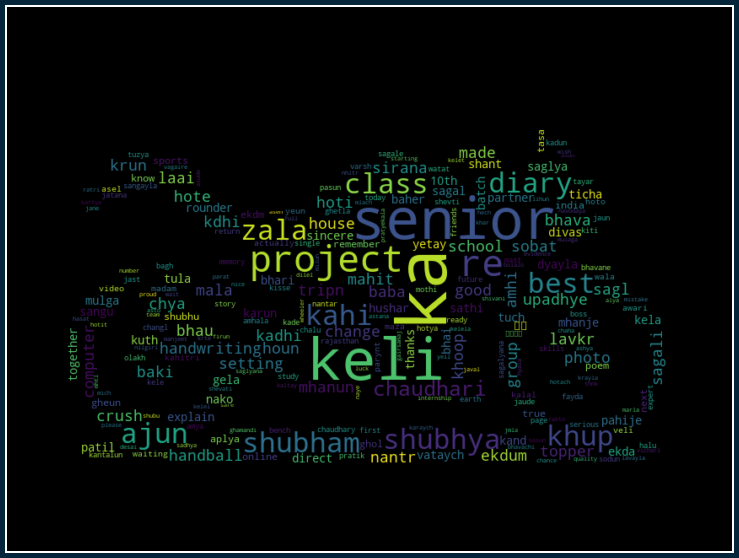

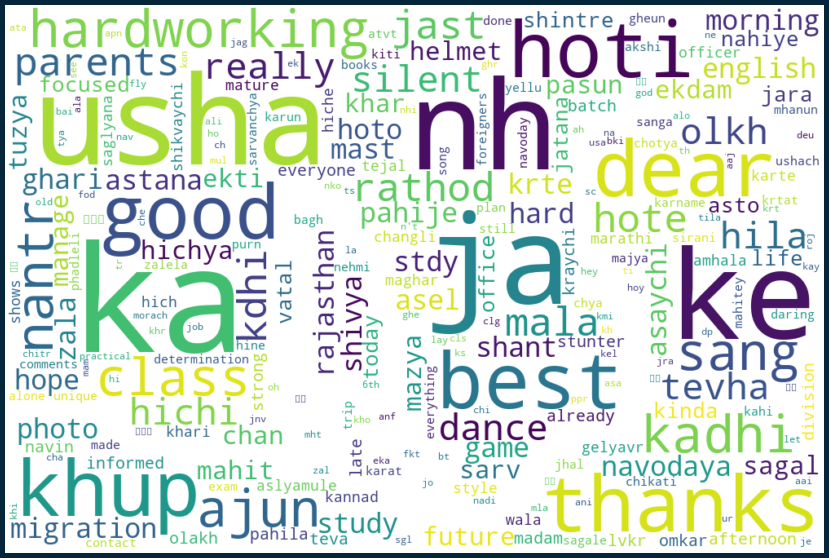

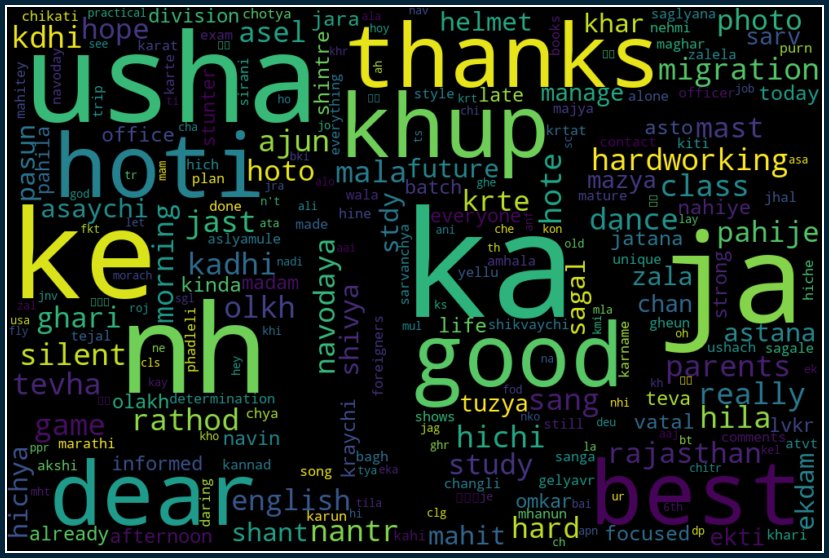

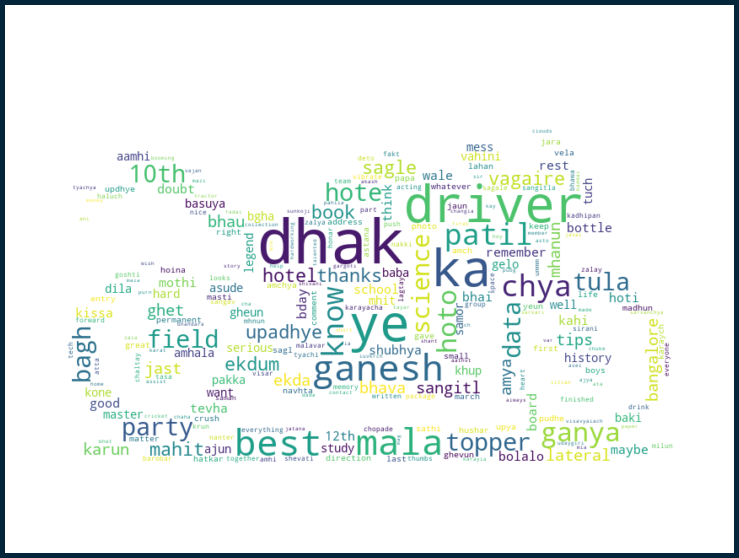

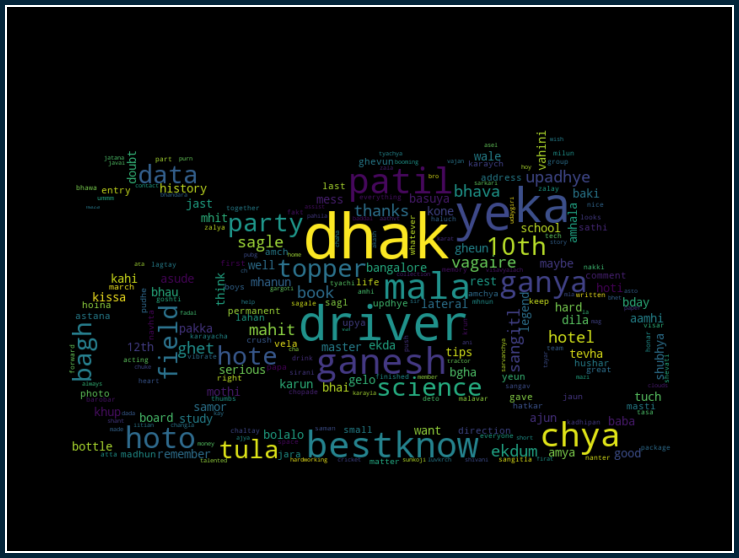

In [121]:
'''Words analysis'''
fpr = open("whatsapp_data/FoDs_datwise2.txt")
fods = fpr.readlines()
fpr.close()


image_for_date = {}
for fod in fods:
    date,name,pic_path = fod.strip().split('|')
    if pic_path=="":
        pic_path="mask_data/photo-1520556016424-01415cf26f0e.jpeg"
    image_for_date[date] = [str(name),str(pic_path)]


#date_s = ['6/5/20']#['5/31/20','6/1/20','6/2/20','6/3/20']
date_s = list(image_for_date.keys())
for date_ in date_s:
    all_lines = df[df['date']==date_]['words'].values
    all_words = []

    for l in all_lines:
        all_words += (l)

    sentence = " ".join(all_words) 
    example_sent = sentence.lower()
    stop_words = set(stopwords.words('english'))

    word_tokens = word_tokenize(example_sent) 
    filtered_sentence = [w for w in word_tokens if not w in stop_words] 

    filtered_sentence = []   
    for w in word_tokens: 
        if w not in stop_words: 
            filtered_sentence.append(w)


    all_words_wo_stopwords = filtered_sentence
    ctr = Counter(all_words_wo_stopwords)
    srtd = sorted(ctr.items(),key=lambda x:x[1],reverse=True)
    
    '''
    l1 = list(filter(lambda x:3>=len(x[0])>1,srtd))
    l2 = list(filter(lambda x:len(x[0])>3,srtd))
    l = l2+l1+l2
    '''
    l = list(filter(lambda x:len(x[0])>3,srtd)) #word_lenght>3
    l = list(filter(lambda x:x[1]>1,l))#frequency>1
    if len(l)<1000:
        l += list(filter(lambda x:2<=len(x[0])<=3,srtd))
    l+= [image_for_date[date_][0].split("_")[0]]*5
    cloud_dataset = [i[0] for i in l[:1100]]
    
    ''' Word Cloud'''
    STOPWORDS =STOPWORDS | set(['sponsor','nahi','ahe','message','omitted','deleted','media','word','hota','hot','zali','zaly','asta','sirancha','girl','akshe','aahe'])
    STOPWORDS =STOPWORDS | set(['ky','hy','pan','pn','vr','mg','te','ki','ha','ny','pan','ahet','aadhi','adhi','madhye','madhye','te','ki','mi'])
    STOPWORDS =STOPWORDS | set(['mi','tu','madhe','mdhe',])
    dataset = " ".join(cloud_dataset)#" ".join(all_words_wo_stopwords)#open("sampleWords.txt", "r").read()
    dataset = dataset.lower()#+" ".join(all_emojis_isolated)
    
    #Method - II
    # create coloring from image
    char_mask = np.array(Image.open(image_for_date[date_][1]))    
    image_colors = ImageColorGenerator(char_mask)
    for c in ["white","black"]:
        cloud = WordCloud(background_color = c, mask=char_mask,max_words = 250, stopwords = set(STOPWORDS))
        cloud.generate(dataset)

        fig=plt.figure(figsize=[20,10],frameon=True,edgecolor='#04253a',linewidth=10)
        #plt.imshow(cloud.recolor(color_func=image_colors), interpolation="bilinear")
        plt.imshow(cloud, interpolation="bilinear")
        plt.axis("off")

        # store to file
        plt.savefig("output/"+image_for_date[date_][0]+"_"+c+".jpg", format="jpg",edgecolor=fig.get_edgecolor())
        plt.show()
    

In [112]:
date_s = list(image_for_date.keys())

In [ ]:
'''
Shivrra
'''

In [72]:
cloud_dataset = ["🚩 🚩 “प्रौढ प्रताप पुरंदर”🚩🚩“महापराक्रमी रणधुरंदर”“क्षत्रिय कुलावतंस्”“सिंहासनाधीश्वर”“महाराजाधिराज”“महाराज”“श्रीमंत”“श्री”“श्री”“श्री”“छत्रपती”“शिवाजी”“महाराज”“की”"]
cloud_dataset = cloud_dataset[0].split()

In [75]:
cloud_dataset

['🚩',
 '🚩',
 '“प्रौढ',
 'प्रताप',
 'पुरंदर”🚩🚩“महापराक्रमी',
 'रणधुरंदर”“क्षत्रिय',
 'कुलावतंस्”“सिंहासनाधीश्वर”“महाराजाधिराज”“महाराज”“श्रीमंत”“श्री”“श्री”“श्री”“छत्रपती”“शिवाजी”“महाराज”“की”']

In [74]:
STOPWORDS =STOPWORDS | set(['nahi','ahe','message','omitted','deleted','media','word','hota','zali','zaly','asta','sirancha','girl','akshe','aahe'])
dataset = " ".join(cloud_dataset)#" ".join(all_words_wo_stopwords)#open("sampleWords.txt", "r").read()
dataset = dataset.lower()#+" ".join(all_emojis_isolated)

#Method - II
# create coloring from image
char_mask = np.array(Image.open(image_for_date[date_][1]))    
image_colors = ImageColorGenerator(char_mask)
for c in ["white","black"]:
    cloud = WordCloud(font_path='aerial',background_color = c, mask=char_mask,max_words = 250, stopwords = set(STOPWORDS))
    cloud.generate(dataset)

    fig=plt.figure(figsize=[25,12],frameon=True,edgecolor='#04253a',linewidth=10)
    #plt.imshow(cloud.recolor(color_func=image_colors), interpolation="bilinear")
    plt.imshow(cloud, interpolation="bilinear")
    plt.axis("off")

    # store to file
    plt.savefig("output/"+image_for_date[date_][0]+"_"+c+".png", format="png",edgecolor=fig.get_edgecolor())
    plt.show()

OSError: cannot open resource